In [2]:
# basic libraries
import math
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import cohen_kappa_score

# torch libraries
import torch
from torch.utils.data import DataLoader
from torchvision import transforms, models, datasets
from torch import nn
from torch_snippets import Report
from torchsummary import summary
import torch.optim as optim




[07/02/23 21:29:00] WARNING  Unable to load torch and dependent libraries from                ]8;id=37931;file:///home/c97818a/mo434_venv/lib/python3.8/site-packages/torch_snippets/loader.py\loader.py]8;;\:]8;id=547320;file:///home/c97818a/mo434_venv/lib/python3.8/site-packages/torch_snippets/loader.py#<module>:98\<module>:98]8;;\
                             torch-snippets.                                                                       
                             Functionalities might be limited. pip install lovely-tensors in                       
                             case there are torch related errors                                                   

# Renaming images

In [3]:

root_path = "images_mo434/"

fish_types = {
              'Black Sea Sprat': '000',
              'Gilt-Head Bream': '001', #x.JPG
              'Hourse Mackerel': '002',
              'Red Mullet': '003',
              'Red Sea Bream': '004', #100-146x.JPG
              'Sea Bass': '005', #x.JPG
              'Shrimp': '006',
              'Striped Red Mullet': '007',
              'Trout': '008'
              }

In [4]:
# renaming images - do it only once, that's why is commented


# for f_type in fish_types:
#   for i,file_name in enumerate(os.listdir(root_path+f_type)):
#     os.rename(os.path.join(root_path, f_type, file_name), f'images_mo434/old_fish/{fish_types[f_type]}_{str(i)}.png')

# Preparing dataset

Falta criar o dataset de par

In [5]:
fish_path ="old_fish/"
fish_path
img_paths = [fish_path+x for x in os.listdir(fish_path)]

In [6]:
file_path = img_paths[0]
img_pil = Image.open('old_fish/006_1.png')
# img_pil = Image.open(file_path)


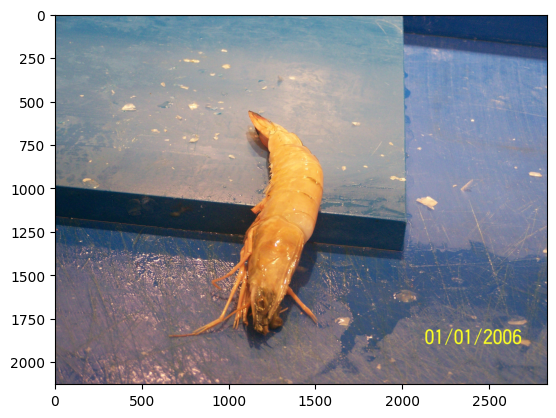

In [7]:

plt.imshow(img_pil)

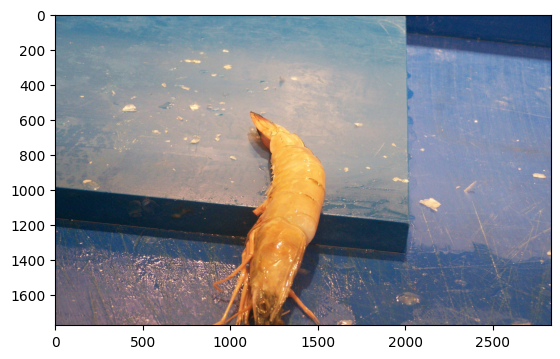

In [8]:
width, height = img_pil.size
 
# Setting the points for cropped image
left = 0
top = 0
right = width
bottom = height-height/6
 
# Cropped image of above dimension
# (It will not change original image)
im1 = img_pil.crop((left, top, right, bottom))

plt.imshow(im1)

In [9]:
# originally images have 1024x768
xsize = 512 # pixels
ysize = 384
nchannels = 3
maxval = 255 # pixel value

# percentages of samples to split
train_perc = 0.6
valid_perc = 0.3
test_perc = 0.1

In [10]:
num_train_samples = int(len(img_paths)*train_perc)
num_valid_samples = int(len(img_paths)*valid_perc)
num_test_samples = int(len(img_paths)*test_perc)

np.random.shuffle(img_paths)

train_set = img_paths[:num_train_samples]
valid_set = img_paths[num_train_samples:num_train_samples+num_valid_samples]
test_set = img_paths[num_train_samples+num_valid_samples:]

print(f"Train size: {len(train_set)}\nValid size: {len(valid_set)}\nTest size: {len(test_set)}")

Train size: 258
Valid size: 129
Test size: 43


In [11]:
# # Augmenting the dataset virtually - the augmentation will make sure the images are different
# import random
# train_set = random.choices(train_set,k=500)
# print(f"Train size: {len(train_set)}\nValid size: {len(valid_set)}\nTest size: {len(test_set)}")

In [12]:
# rgb_values = np.concatenate(
#     [Image.open(img).getdata() for img in img_paths], 
#     axis=0
# ) / 255.

# mean_val_pixel = np.mean(rgb_values, axis=0)  # mu_rgb.shape == (3,)
# std_val_pixel = np.std(rgb_values, axis=0)  # std_rgb.shape == (3,)

#calculate this takes too long, so I wrote the result here:
mean_val_pixels = (0.420,0.424,0.460)
std_val_pixels = (0.230, 0.174 ,0.160)

print(f"Mean value of pixels: {mean_val_pixels}\nStandard deviation of pixels values: {std_val_pixels}")

Mean value of pixels: (0.42, 0.424, 0.46)
Standard deviation of pixels values: (0.23, 0.174, 0.16)


In [13]:
# Defining preprocessing transforms
prep = transforms.Compose([
    transforms.Resize((xsize, ysize), interpolation=transforms.InterpolationMode.BILINEAR,
                      max_size=None, antialias=True),
    transforms.ToTensor(),
    transforms.Normalize(mean_val_pixels, std_val_pixels) # mean, std
])

aug  = transforms.Compose([
    transforms.Resize((600,400), interpolation=transforms.InterpolationMode.BILINEAR, 
                      max_size=None, antialias=True),
    transforms.RandomAffine(degrees=10, translate=(0.05,0.10), scale=(0.9,1.1), shear=(-2,2),
                            interpolation=transforms.InterpolationMode.BILINEAR, 
                            fill=0),
    transforms.CenterCrop(500),
    transforms.Resize((xsize,ysize), interpolation=transforms.InterpolationMode.BILINEAR, 
                      max_size=None, antialias=True),
    transforms.ToTensor(),
    transforms.Normalize(mean_val_pixels, std_val_pixels)
])

In [14]:
class ImageDataSet():

    def __init__(self, dataset, transform=None):
        self.dataset = dataset # list of image paths
        self.targets = [int(str(x).split("/")[-1].split("_")[0]) for x in self.dataset]
        self.transform = transform

    def __len__(self): 
        return len(self.dataset)

    def __getitem__(self, ix): #ix is the position
        filename = self.dataset[ix]
        target = self.targets[ix]
        image = Image.open(filename)
        #cropping the date (or part of the image, anyway)
        w, h = image.size
        left = 0
        top = 0
        right = w
        bottom = h-h/6
        image = image.crop((left, top, right, bottom))
        # transforming
        if self.transform is not None:
            image = self.transform(image)
        else:
            image = torch.from_numpy(np.array(image)).permute(2,0,1).float()
        return(image, target)


In [15]:
def GetBatches(dataset, batchsize, transformation):
    datatensor = ImageDataSet(dataset, transformation)
    dataloader = DataLoader(datatensor, batch_size=batchsize, shuffle=True)
    return dataloader

In [16]:
batchsize = 30

trainload = GetBatches(train_set, batchsize, aug)  
validload = GetBatches(valid_set, batchsize, prep)
testload  = GetBatches(test_set, batchsize, prep) 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


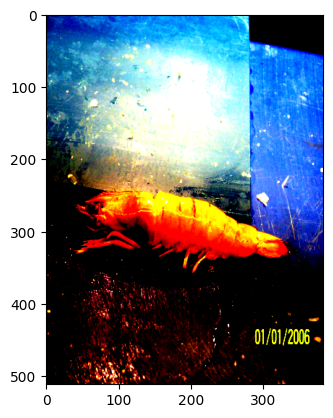

In [17]:
img_cam = Image.open(valid_set[0])
img_cam = prep(img_cam)
plt.imshow(img_cam.permute(1, 2, 0))

# CNN

In [18]:
# convolutional block
def conv_block(nchannels_in, nchannels_out, stride_val):
    return nn.Sequential(
        nn.Conv2d(in_channels=nchannels_in, out_channels=nchannels_out, 
                  kernel_size=(3,3), stride=1, padding=1, bias=False), 
        # stride é o passo que o kernel anda
        nn.BatchNorm2d(num_features=nchannels_out),
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=(3,3), stride=stride_val, padding=1)
  )

In [19]:
class FishClassification(nn.Module):

    def _initialize_weights(self): #Xavier Initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                #number of elements in the layer
                n = m.kernel_size[0]*m.kernel_size[1]*m.in_channels
                #init weights with random values from normal distribution
                m.weight.data.normal_(mean=0, std=math.sqrt(2/n))
                if m.bias is not None:
                    m.bias.data.zero_()

            elif isinstance(m, nn.Linear):
                m.weight.data.normal_(mean=0, std=0.01)
                if m.bias is not None:
                    m.bias.data.zero_()

    def __init__(self, num_classes):
        super(FishClassification, self).__init__()

        self.conv1 = conv_block(3,16,1) # no exemplo era (1,16,1)
        self.conv2 = conv_block(16, 64, 2)
        self.conv3 = conv_block(80, 128, 2)
        self.conv4 = conv_block(128, 256, 2)
        self.conv5 = conv_block(384, 512, 2)

        self.classifier = nn.Sequential(
            nn.Linear(in_features=int( (xsize*ysize*(512))/(2*2*2*2*4*4) ),
                    out_features=512, bias=True),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(512, num_classes)
        )
        self._initialize_weights()
        

    def forward(self, x):
        #extracts features
        x1 = self.conv1(x)
        x2 = self.conv2(x1)
        # x1 and x2 need same dimension
        x1 = torch.nn.functional.interpolate(x1, 
                                            scale_factor=(0.5,0.5),
                                            mode='nearest',
                                            recompute_scale_factor=True)
        #skip connection
        x = torch.cat((x1, x2), dim=1)

        x3 = self.conv3(x)
        x4 = self.conv4(x3)

        x3 = torch.nn.functional.interpolate(x3, 
                                            scale_factor=(0.5,0.5),
                                            mode='nearest',
                                            recompute_scale_factor=True)
        #skip connection
        x = torch.cat((x3, x4), dim=1)
        x5 = self.conv5(x)
        print(x5)
        #outputs to 2D tensor
        x = torch.flatten(x5, start_dim=1)
        #classifies features
        y = self.classifier(x)
        return y


In [20]:
# defining device
gpu = torch.cuda.is_available()
device = torch.device(0) if gpu else torch.device('cpu')

In [21]:
model = FishClassification(num_classes=9).to(device)

### Loss function and optimizer

In [23]:
def criterion(preds, targets):
    cross_ent = nn.CrossEntropyLoss().to(device)
    loss = cross_ent(preds, targets.long())
    pred_labels = torch.max(preds,1)[1] #argmax
    acc = torch.sum(pred_labels == targets.data)
    n = pred_labels.size(0)
    acc = acc/n
    return loss, acc

In [24]:

#Stochastic Gradient Descent
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.85,
                      weight_decay=0.0001)

# learning rate scheduler (factor gamma at every 25 epocs)
lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=25, gamma=0.1)

### Defining train, validation and test

In [25]:
def train_batch(model, data, optimizer, criterion, device):
    model.train()
    ims, targets = data
    ims = ims.to(device=device)
    targets = targets.to(device=device)
    preds = model(ims)
    loss, acc = criterion(preds, targets)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    return loss.item(), acc.item()

@torch.no_grad()
def validate_batch(model, data, criterion, device):
    model.eval()
    ims, targets = data
    ims = ims.to(device=device)
    targets = targets.to(device=device)
    preds = model(ims)
    loss, acc = criterion(preds, targets)
    return loss.item(), acc.item()

def Test_per_class(model, testload, device):

    kappa = []
    acc = []

    for _, data in enumerate(testload):
        # take original data
        ims, target = data
        ims = ims.to(device=device)
        target = target.to(device=device)
        # run model to see predicted
        preds = model(ims)
        pred_labels = torch.max(preds, 1)[1] #same as argmax
        # calculate accurancy and cohens kappa
        for val_target, val_pred in zip(target.tolist(),pred_labels.tolist()):
            accur = int(val_target==val_pred)
            acc.append(accur)
            kappa.append(cohen_kappa_score(np.array([val_target]), np.array([val_pred])))
    

    kappa = [1 if math.isnan(x) else x for x in kappa]
    mean_kappa = np.mean(kappa)
    mean_acc = np.mean(acc)
    std_kappa = np.std(kappa)
    std_acc = np.std(acc)

    return ([mean_kappa, std_kappa, mean_acc, std_acc])

In [26]:
summary(model, (nchannels, ysize, xsize))

tensor([[[[1.1158, 1.2954, 1.2954,  ..., 1.4813, 1.3409, 1.9162],
          [0.9299, 1.2210, 1.2018,  ..., 1.2043, 1.2792, 1.3771],
          [0.8462, 1.2005, 1.2497,  ..., 1.2043, 0.9774, 1.3771],
          ...,
          [0.9780, 1.0706, 1.2180,  ..., 1.2717, 1.1559, 1.5265],
          [0.9780, 1.2570, 1.0706,  ..., 1.1740, 1.0346, 1.3494],
          [1.4891, 1.9217, 1.6856,  ..., 1.8826, 1.7545, 1.8831]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[2.1602, 2.2531, 2.2531,  ..., 1.7982, 1.8440, 1.8346],
          [2.1602, 2.2531, 2.2531,  ..., 1.9707, 1.7982, 1.8346],
          [2.1846, 1.7807, 1.8740,  ..., 1

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 384, 512]        --
|    └─Conv2d: 2-1                       [-1, 16, 384, 512]        432
|    └─BatchNorm2d: 2-2                  [-1, 16, 384, 512]        32
|    └─ReLU: 2-3                         [-1, 16, 384, 512]        --
|    └─MaxPool2d: 2-4                    [-1, 16, 384, 512]        --
├─Sequential: 1-2                        [-1, 64, 192, 256]        --
|    └─Conv2d: 2-5                       [-1, 64, 384, 512]        9,216
|    └─BatchNorm2d: 2-6                  [-1, 64, 384, 512]        128
|    └─ReLU: 2-7                         [-1, 64, 384, 512]        --
|    └─MaxPool2d: 2-8                    [-1, 64, 192, 256]        --
├─Sequential: 1-3                        [-1, 128, 96, 128]        --
|    └─Conv2d: 2-9                       [-1, 128, 192, 256]       92,160
|    └─BatchNorm2d: 2-10                 [-1, 128, 192, 256]       256
|    

In [27]:
# training and validation
n_epochs = 100
log = Report(n_epochs)

for ex in range(n_epochs):
    N = len(trainload)
    for bx, data in enumerate(trainload):
        loss, acc = train_batch(model, data, optimizer, criterion, device)
        log.record((ex+(bx+1)/N), trn_loss = loss, trn_acc = acc, end='\r')

    N = len(validload)
    for bx, data in enumerate(validload):
        loss, acc = validate_batch(model, data, criterion, device)
        log.record((ex+(bx+1)/N), val_loss=loss, val_acc=acc, end='\r')

    if (ex+1) % 10 == 0: 
        log.report_avgs(ex+1)
        
    lr_scheduler.step()

tensor([[[[0.0000e+00, 4.2099e-01, 2.7307e+00,  ..., 2.9724e+00,
           2.0790e+00, 6.1616e-02],
          [0.0000e+00, 4.2099e-01, 2.7263e+00,  ..., 2.9724e+00,
           2.0790e+00, 6.1616e-02],
          [0.0000e+00, 0.0000e+00, 1.7433e+00,  ..., 2.3735e+00,
           2.8987e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 5.3625e-01,  ..., 3.5443e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 7.9400e-01,  ..., 3.5443e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 4.4695e-03, 1.3647e+00,  ..., 2.0602e+00,
           0.0000e+00, 0.0000e+00]],

         [[1.5303e+00, 1.5303e+00, 5.9118e-01,  ..., 1.4211e+00,
           1.2610e+00, 1.1498e+00],
          [1.0726e+00, 1.0726e+00, 0.0000e+00,  ..., 2.0947e+00,
           2.0947e+00, 7.7471e-01],
          [1.0726e+00, 1.0726e+00, 0.0000e+00,  ..., 2.0947e+00,
           2.0947e+00, 7.7471e-01],
          ...,
          [1.0726e+00, 1.0726e+00, 2.0755e-01,  ..., 2.1222

EPOCH: 0.111  trn_loss: 2.939  trn_acc: 0.067  (1.51s - 1354.22s remaining)tensor([[[[8.6149e-03, 3.0418e-01, 1.7005e+00,  ..., 2.0915e+00,
           1.8787e+00, 1.6674e+00],
          [8.6149e-03, 3.0418e-01, 1.7387e+00,  ..., 2.7690e+00,
           1.8787e+00, 1.0720e+00],
          [0.0000e+00, 0.0000e+00, 2.2187e+00,  ..., 2.2943e+00,
           8.8587e-01, 4.0038e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 3.2185e+00,  ..., 1.2368e+00,
           8.4394e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 3.2409e+00,  ..., 1.2368e+00,
           3.8546e-01, 0.0000e+00],
          [0.0000e+00, 1.8007e-01, 2.5751e+00,  ..., 2.0366e+00,
           8.7575e-01, 7.0301e-01]],

         [[1.5473e+00, 1.5473e+00, 7.4577e-01,  ..., 2.2952e-01,
           1.7968e+00, 1.1576e+00],
          [1.0908e+00, 1.0908e+00, 4.2542e-01,  ..., 7.5998e-01,
           1.2700e+00, 1.2700e+00],
          [1.0908e+00, 1.0908e+00, 4.4435e-01,  ..., 7.9715e-01,
           1.2840e+00, 1.2840e+00],

100%|██████████| 201/201 [00:00<00:00, 6241.34it/s]


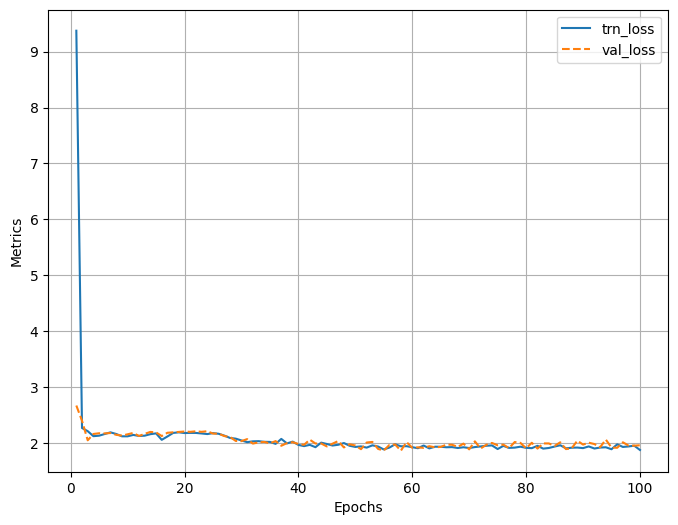

100%|██████████| 201/201 [00:00<00:00, 6471.95it/s]


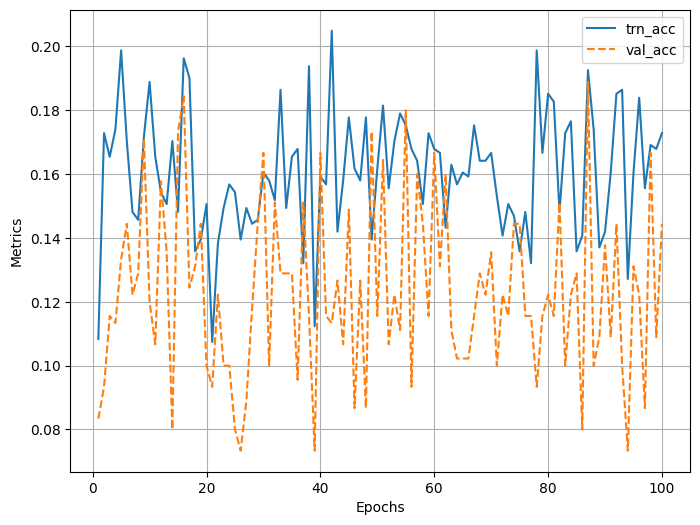

In [28]:
# results from training and validation
log.plot_epochs(['trn_loss', 'val_loss'])
log.plot_epochs(['trn_acc', 'val_acc'])

## Testing

In [29]:
# MELHOR TESTAR INPUTANDO SÓ UMA CLASSE
testset0 = [x for x in test_set if "000_" in x]
testload0  = GetBatches(testset0, batchsize, prep) 
testset1 = [x for x in test_set if "001_" in x]
testload1  = GetBatches(testset1, batchsize, prep) 
testset2 = [x for x in test_set if "002_" in x]
testload2  = GetBatches(testset2, batchsize, prep) 
testset3 = [x for x in test_set if "003_" in x]
testload3  = GetBatches(testset3, batchsize, prep) 
testset4 = [x for x in test_set if "004_" in x]
testload4  = GetBatches(testset4, batchsize, prep) 
testset5 = [x for x in test_set if "005_" in x]
testload5  = GetBatches(testset5, batchsize, prep) 
testset6 = [x for x in test_set if "006_" in x]
testload6  = GetBatches(testset6, batchsize, prep)
testset7 = [x for x in test_set if "007_" in x]
testload7  = GetBatches(testset7, batchsize, prep) 
testset8 = [x for x in test_set if "008_" in x]
testload8  = GetBatches(testset8, batchsize, prep) 

In [30]:

m0 = Test_per_class(model, testload0, device)
m1 = Test_per_class(model, testload1, device)
m2 = Test_per_class(model, testload2, device)
m3 = Test_per_class(model, testload3, device)
m4 = Test_per_class(model, testload4, device)
m5 = Test_per_class(model, testload5, device)
m6 = Test_per_class(model, testload6, device)
m7 = Test_per_class(model, testload7, device)
m8 = Test_per_class(model, testload8, device)


tensor([[[[0.0000, 0.0000, 0.0925,  ..., 2.6413, 3.7452, 3.9660],
          [0.0000, 0.0707, 0.1066,  ..., 2.6413, 3.7452, 3.9660],
          [0.0000, 0.0524, 0.1066,  ..., 2.7669, 3.5219, 3.8629],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.8715, 2.0043, 2.0931],
          [0.0000, 0.0000, 0.0000,  ..., 1.0794, 2.0372, 2.1648],
          [0.0000, 0.0000, 0.0000,  ..., 1.2392, 1.8992, 2.1236]],

         [[1.0467, 1.0565, 1.0349,  ..., 0.1398, 0.0000, 0.0000],
          [1.1293, 1.1293, 1.3158,  ..., 0.1398, 0.0000, 0.0000],
          [1.1293, 1.1429, 1.3158,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.9674, 0.9674, 0.9205,  ..., 0.6799, 0.0000, 0.0000],
          [0.9564, 0.9564, 0.9192,  ..., 0.7517, 0.0000, 0.0000],
          [0.9564, 0.9564, 0.9145,  ..., 0.7299, 0.0000, 0.0000]],

         [[0.2834, 0.2543, 0.1015,  ..., 2.7975, 3.7461, 4.1724],
          [0.2834, 0.2552, 0.2552,  ..., 2.7975, 3.7461, 4.1724],
          [0.1803, 0.2552, 0.2552,  ..., 2

/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar d

In [31]:

df_metrics = pd.DataFrame(columns=['Mean kappa', 'Std kappa', 'Mean accuracy', 'Std accuracy'])
df_metrics.loc[len(df_metrics)] = m0
df_metrics.loc[len(df_metrics)] = m1
df_metrics.loc[len(df_metrics)] = m2
df_metrics.loc[len(df_metrics)] = m3
df_metrics.loc[len(df_metrics)] = m4
df_metrics.loc[len(df_metrics)] = m5
df_metrics.loc[len(df_metrics)] = m6
df_metrics.loc[len(df_metrics)] = m7
df_metrics.loc[len(df_metrics)] = m8


In [32]:
fish_numbers = {
              0:'Black Sea Sprat',
              1:'Gilt-Head Bream', 
              2:'Hourse Mackerel',
              3:'Red Mullet',
              4:'Red Sea Bream', 
              5:'Sea Bass',
              6:'Shrimp',
              7:'Striped Red Mullet',
              8:'Trout'
              }
df_metrics['Fish class']=[fish_numbers[i] for i in range(len(df_metrics))]
df_metrics

,Mean kappa,Std kappa,Mean accuracy,Std accuracy,Fish class
0,0.0,0.0,0.0,0.0,Black Sea Sprat
1,0.0,0.0,0.0,0.0,Gilt-Head Bream
2,0.0,0.0,0.0,0.0,Hourse Mackerel
3,0.0,0.0,0.0,0.0,Red Mullet
4,0.0,0.0,0.0,0.0,Red Sea Bream
5,0.0,0.0,0.0,0.0,Sea Bass
6,1.0,0.0,1.0,0.0,Shrimp
7,1.0,0.0,1.0,0.0,Striped Red Mullet
8,0.0,0.0,0.0,0.0,Trout


# Grad-CAM: Gradient weighted Class Activation Mapping
From notebook 9.visualize-pytorch-model-outputs

In [34]:
import matplotlib.cm as cm
import cv2

In [35]:
# meu model tem conv 1 a 5

def get_activations(model, x, device):
    # I'm redoing forward so I can acess the output
    # move input tensor x to the selected device
    x = x.to(device)
    # get activations after feature extraction
    x1 = model.conv1(x)
    x2 = model.conv2(x1)
    x1 = torch.nn.functional.interpolate(x1, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x1, x2), dim=1)
    x3 = model.conv3(x)
    x4 = model.conv4(x3)

    x3 = torch.nn.functional.interpolate(x3, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x3, x4), dim=1)
    x5 = model.conv5(x)
    return x5

def get_output_of_the_model(model, x, device):
    # put the model in the evaluation mode
    model.eval()
    # move input tensor x to the selected device
    x =x.to(device)
    # execute the model with gradients
    output = model(x)
    return output

def get_heatmap(model, x, device, model_name, label_maps):
    # add one dimension (dim=0 must be the number of images)
    xin = x.unsqueeze(0)
    #get the  output of the feature extractor
    activ = get_activations(model, xin, device)

    # get the predictionsat the output of the decision layer
    logits = get_output_of_the_model(model, xin, device)

    # get the most confident prediction
    pred = logits.max(-1)[-1]
    print("predicted label:", pred.cpu().detach().numpy()[0])

    # compute gradients with respect to the most confident prediction
    model.zero_grad()
    logits[0, pred].backward(retain_graph=True)

    print(activ.shape)
    # only conv2d generates gradients in the feature extractor: extracts them
    for layer_name, layer in model.conv1.named_children():
        if layer_name == '0':
            grad1 = layer.weight.grad
            nchannels1 = grad1.shape[0]
            # compute the weighted mean of the activations across channels 
            # using the mean value of the gradient of each filter parameter as weight
            for i in range(16):
                activ[:, i, :, :] *= grad1[i].mean()
    
    for layer_name, layer in model.conv2.named_children():
        if layer_name=='0':
            grad2 = layer.weight.grad
            nchannels2 = grad2.shape[0]
            for i in range(64):
                activ[:, i+16, :, :] *= grad2[i].mean()
    
    heatmap = torch.mean(activ, dim=1)[0].cpu().detach()

    # convert to numpy, normalize, and resize to the input size
    heatmap = heatmap.squeeze(0).numpy()
    heatmap = (heatmap - heatmap.min())/(heatmap.max()-heatmap.min())
    heatmap = cv2.resize(heatmap, (x.shape[2], x.shape[1]))
    return heatmap

def display_image_with_heatmap(img, heatmap, scale):
    heatmap = np.uint8(255 * heatmap)
    width = int(heatmap.shape[1]*scale)
    height = int (heatmap.shape[0]*scale)
    heatmap = cv2.resize(heatmap, (width, height))
    img = cv2.resize(img,(width, height))
    heatmap = cv2.applyColorMap(255-heatmap, cv2.COLORMAP_JET)
    heatmap = np.uint8(heatmap)
    heatmap = np.uint8(heatmap*0.7 + img*0.3)
    plt.imshow(heatmap)
    plt.show()


In [36]:
target_from_tensor = str(valid_set[0]).split("/")[-1].split("_")[0]

from PIL import Image

img_cam = Image.open(valid_set[0])
img_cam = prep(img_cam)

True label:  006
tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 1.2909, 1.4750, 1.3090],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0248, 0.0181],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[1.1397, 1.1397, 1.0093,  ..., 0.9298, 0.9322, 0.9999],
          [1.1772, 1.1772, 1.0291,  ..., 0.7903, 0.7903, 0.8607],
          [1.0948, 1.0948, 1.0117,  ..., 0.7357, 0.7517, 0.8575],
          ...,
          [0.9750, 0.9750, 0.9419,  ..., 0.4369, 0.5325, 0.9666],
          [0.9750, 0.9870, 0.9870,  ..., 0.9120, 1.0176, 1.0176],
          [0.9187, 0.9653, 0.9653,  ..., 0.9104, 0.9756, 0.9756]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000

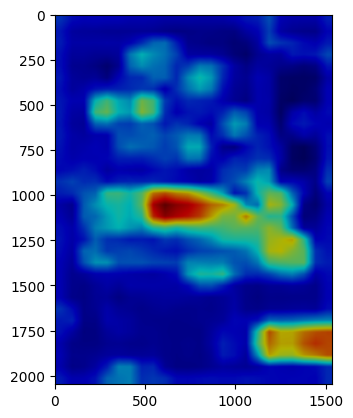

In [37]:
x = img_cam
x = x.float()
true_label = target_from_tensor
print("True label: ", true_label)
heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
x = x.permute(1,2,0).numpy()
if x.shape[2]==1: #convert it to three channels
    x =  x.squeeze(2)
    x = np.stack((x,)*3, axis=-1)
display_image_with_heatmap(x, heatmap, 4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


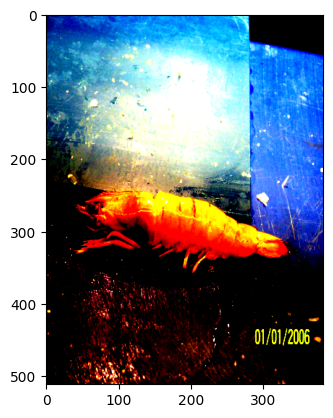

In [38]:
plt.imshow(img_cam.permute(1, 2, 0))

True label:  000
tensor([[[[0.0000, 0.0000, 0.0431,  ..., 2.5668, 3.7458, 3.8744],
          [0.0000, 0.0241, 0.0488,  ..., 2.6354, 3.7458, 3.8744],
          [0.0000, 0.0062, 0.0154,  ..., 2.6902, 3.2638, 3.7728],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.7780, 1.2798, 1.2798],
          [0.0000, 0.0000, 0.0000,  ..., 0.5701, 0.8574, 0.8574],
          [0.0000, 0.0000, 0.0000,  ..., 0.1449, 0.4877, 0.5266]],

         [[1.0496, 1.1027, 1.0496,  ..., 0.0000, 0.0000, 0.0000],
          [1.0991, 1.1395, 1.3029,  ..., 0.0000, 0.0000, 0.0000],
          [1.1585, 1.1585, 1.2582,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.8682, 0.8682, 0.8111,  ..., 0.8803, 0.4901, 0.3623],
          [0.7937, 0.8009, 0.8112,  ..., 0.9604, 0.6656, 0.3781],
          [0.7240, 0.7240, 0.7637,  ..., 0.9256, 0.7025, 0.4414]],

         [[0.2602, 0.2602, 0.1187,  ..., 2.6189, 3.6950, 4.1630],
          [0.2602, 0.2602, 0.1597,  ..., 2.6625, 3.6950, 4.1630],
          [0.1696, 0.1696

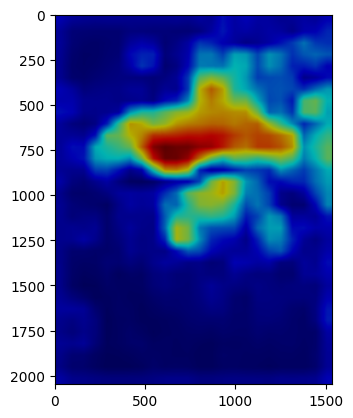

In [39]:
def display_image_with_heatmap_batch(heatmap, scale):
    heatmap = np.uint8(255 * heatmap)
    width = int(heatmap.shape[1]*scale)
    height = int (heatmap.shape[0]*scale)
    heatmap = cv2.resize(heatmap, (width, height))
    heatmap = cv2.applyColorMap(255-heatmap, cv2.COLORMAP_JET)
    heatmap = np.uint8(heatmap)
    heatmap = np.uint8(heatmap*0.7 )
    plt.imshow(heatmap)
    plt.show()

# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset0:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)

True label:  003
tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0909, 0.0909, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0909, 0.0909, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 1.1407, 0.7722, 0.5071],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.8472, 0.8472, 0.8762,  ..., 0.9006, 0.7537, 0.8037],
          [0.8715, 0.8715, 1.0076,  ..., 1.0016, 1.0460, 1.0148],
          [0.9764, 0.9764, 1.0076,  ..., 1.0016, 1.0568, 1.0568],
          ...,
          [0.7286, 0.7286, 0.6326,  ..., 1.1640, 1.1625, 0.9823],
          [0.6973, 0.6973, 0.6193,  ..., 1.1640, 1.1625, 1.0807],
          [0.6466, 0.6466, 0.6016,  ..., 1.0453, 1.0597, 1.0570]],

         [[0.0000, 0.0694, 0.0694,  ..., 0.2686, 0.3220, 0.2267],
          [0.0776, 0.0776, 0.0694,  ..., 0.2686, 0.3220, 0.2267],
          [0.1362, 0.1422

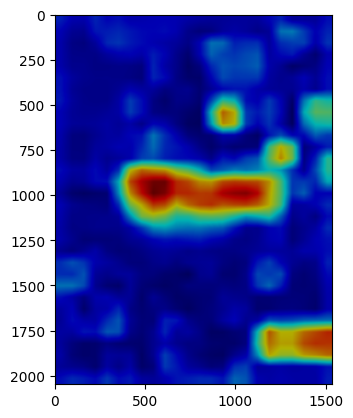

In [40]:
# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset3:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)

True label:  006
tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0180,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0144,  ..., 1.3484, 1.6155, 1.3892],
          [0.0000, 0.0846, 0.2318,  ..., 0.0000, 0.0000, 0.0000],
          [0.1151, 0.1394, 0.2318,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.9922, 0.9922, 0.8759,  ..., 0.9284, 0.9393, 1.0480],
          [1.0171, 1.0171, 0.9745,  ..., 0.8004, 0.7821, 0.9282],
          [1.0521, 1.0521, 0.9828,  ..., 0.6736, 0.6776, 1.1096],
          ...,
          [0.9506, 0.9804, 0.9804,  ..., 0.4712, 0.5994, 1.4207],
          [0.9467, 0.9467, 0.9170,  ..., 1.0843, 1.0843, 1.0758],
          [0.7874, 0.7983, 0.8009,  ..., 1.0843, 1.0843, 1.0578]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000

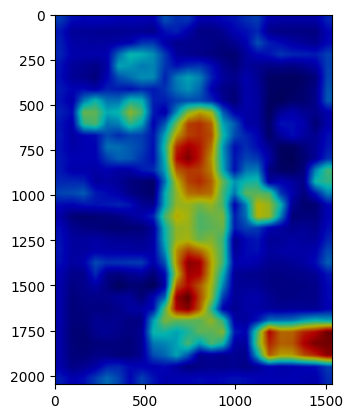

In [41]:
# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset6:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)